### Use any unsupervised technique to extract patterns or segregate data into groups.
### User Story: User should be able to provide a data point (a row) and program should be able to identify to which group given data point belongs to and why?

In [2]:
# importing libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import warnings

#pip install termcolor
from termcolor import cprint

from datetime import datetime

#pip install plotly
import plotly.express as px
import datetime as dt
warnings.filterwarnings('ignore')


In [3]:
#read the file
data = pd.read_csv("D:/ml_tasks/ml_tasks/ml_task_1/data.csv",encoding="ISO-8859-1")

In [276]:
#dimensions of dataset
print('Our datasets contain',data.shape[0],'rows & ',data.shape[1],'columns.')

Our datasets contain 365556 rows &  15 columns.


In [5]:
# Renaming the columns for better understanding
data = data.rename(index=str,columns={'InvoiceNo':'invoice_no',
                              'StockCode':'stock_code',
                              'Description':'description',
                              'Quantity':'quantity',
                              'InvoiceDate':'invoice_date',
                              'UnitPrice':'unit_price',
                              'CustomerID':'customer_id',
                              'Country':'country'})

In [6]:
data.head()

,invoice_no,stock_code,description,quantity,invoice_date,unit_price,customer_id,country
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,12/1/2010 8:26,2.55,17850.0,United Kingdom
1,536365,71053,WHITE METAL LANTERN,6,12/1/2010 8:26,3.39,17850.0,United Kingdom
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,12/1/2010 8:26,2.75,17850.0,United Kingdom
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,12/1/2010 8:26,3.39,17850.0,United Kingdom
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,12/1/2010 8:26,3.39,17850.0,United Kingdom


In [7]:
#Descriptive Analysis
data.describe()

,quantity,unit_price,customer_id
count,541909.000000,541909.000000,406829.000000
mean,9.552250,4.611114,15287.690570
std,218.081158,96.759853,1713.600303
min,-80995.000000,-11062.060000,12346.000000
25%,1.000000,1.250000,13953.000000
50%,3.000000,2.080000,15152.000000
75%,10.000000,4.130000,16791.000000
max,80995.000000,38970.000000,18287.000000


In [8]:
#Descriptive Analysis of object 
data.describe(include=object)

,invoice_no,stock_code,description,invoice_date,country
count,541909,541909,540455,541909,541909
unique,25900,4070,4223,23260,38
top,573585,85123A,WHITE HANGING HEART T-LIGHT HOLDER,10/31/2011 14:41,United Kingdom
freq,1114,2313,2369,1114,495478


In [9]:
data.isnull().sum()

invoice_no           0
stock_code           0
description       1454
quantity             0
invoice_date         0
unit_price           0
customer_id     135080
country              0
dtype: int64

In [10]:
# Let's see duplicates entry in data
data.duplicated().sum()

5268

In [11]:
# dropping duplicates
data.drop_duplicates(inplace=True)

In [12]:
data.shape

(536641, 8)

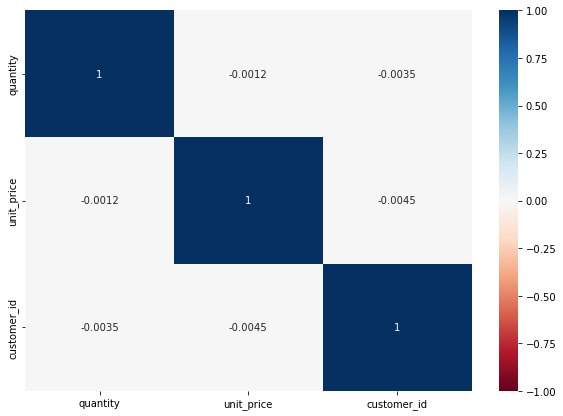

In [13]:
plt.figure(figsize=(10,7))
sns.heatmap(data.corr(),vmax=1,vmin=-1,cmap='RdBu',annot=True)
plt.show()

In [14]:
#Let's see how much unique values in dataset
data.nunique()

invoice_no      25900
stock_code       4070
description      4223
quantity          722
invoice_date    23260
unit_price       1630
customer_id      4372
country            38
dtype: int64

## Exploring Dataset

In [15]:
data.groupby(['country'])['customer_id'].aggregate('count').reset_index().sort_values('customer_id',ascending=False)

,country,customer_id
36,United Kingdom,356728
14,Germany,9480
13,France,8475
10,EIRE,7475
31,Spain,2528
24,Netherlands,2371
3,Belgium,2069
33,Switzerland,1877
27,Portugal,1471
0,Australia,1258


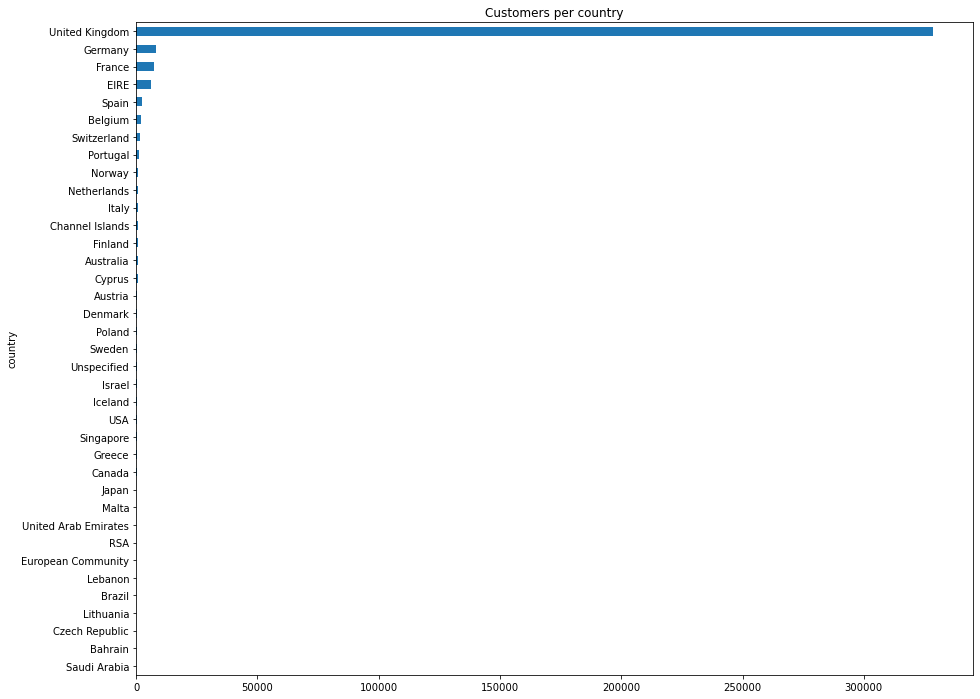

In [277]:
total_customers = data.groupby(['country'])['customer_id'].aggregate('count').sort_values()
total_customers.plot(kind = 'barh',figsize=(15,12))  #barh --> horizontal bar plot
plt.title('Customers per country')
plt.show()


In [278]:
cprint('Well we see we have most of the customers in United Kningdom','red')

Well we see we have most of the customers in United Kningdom


In [279]:
cprint('MOST ORDERED PRODUCTS','blue')
data.groupby(['description'])['quantity'].aggregate('sum').reset_index().sort_values('quantity',ascending=False)

MOST ORDERED PRODUCTS


,description,quantity
2252,PACK OF 72 RETROSPOT CAKE CASES,14986
215,ASSORTED COLOUR BIRD ORNAMENT,13574
1749,JUMBO BAG RED RETROSPOT,12167
3669,WHITE HANGING HEART T-LIGHT HOLDER,10784
1930,LUNCH BAG RED RETROSPOT,9776
...,...,...
352,BLACK DROP EARRINGS W LONG BEADS,1
1208,FIRE POLISHED GLASS BRACELET BLACK,1
1343,FUNKY MONKEY MUG,1
677,CHERRY BLOSSOM PURSE,1


In [280]:
# return False where quantity is positive and return True where quantity is negative
data['cancelled_orders'] = data['quantity']<0

In [281]:
data.head()

,invoice_no,stock_code,description,quantity,invoice_date,unit_price,customer_id,country,cancelled_orders,total_price,ref_date,last_purchase_date,customer_recency,customer_frequency,customer_monetary
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2010-12-01 08:26:00,2.55,17850,United Kingdom,False,15.30,2011-12-09,2010-12-02,372,297,5391.21
1,536365,71053,WHITE METAL LANTERN,6,2010-12-01 08:26:00,3.39,17850,United Kingdom,False,20.34,2011-12-09,2010-12-02,372,297,5391.21
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,2010-12-01 08:26:00,2.75,17850,United Kingdom,False,22.00,2011-12-09,2010-12-02,372,297,5391.21
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,2010-12-01 08:26:00,3.39,17850,United Kingdom,False,20.34,2011-12-09,2010-12-02,372,297,5391.21
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,2010-12-01 08:26:00,3.39,17850,United Kingdom,False,20.34,2011-12-09,2010-12-02,372,297,5391.21


In [282]:
(data['quantity']<0).value_counts()

False    365556
Name: quantity, dtype: int64

#### Cancelled Orders

In [283]:
data.cancelled_orders.value_counts()

False    365556
Name: cancelled_orders, dtype: int64

In [23]:
type(data['cancelled_orders'])

pandas.core.series.Series

In [284]:
#Changing True|False to Not_Satisfied|Satisfied
data['cancelled_orders'] = np.where((data['cancelled_orders']==False),'Satisfied',data['cancelled_orders'])
data['cancelled_orders'] = np.where((data['cancelled_orders']==True),'Not_Satisfied',data['cancelled_orders'])

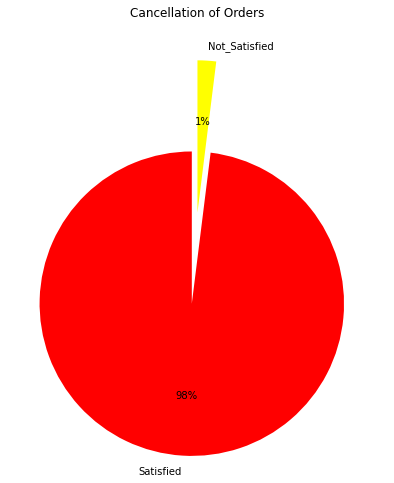

In [25]:
label=['Satisfied','Not_Satisfied']
plt.figure(figsize=(15,7))
plt.title('Cancellation of Orders')
plt.pie(data['cancelled_orders'].value_counts(),autopct='%d%%',labels=label,colors=['red','yellow'],startangle=90,explode=(0.6,0))
plt.show()

In [285]:
cprint("Above we clearly see that our quantity is negative and where quantity is negative there's a 'C' in invoice_no , I think that means Cancelled ",'green')
print()
print()
print()
print()
cprint('And we also see D and M in StockCode columns which means Discount and Manual so we have also treat them','blue')

Above we clearly see that our quantity is negative and where quantity is negative there's a 'C' in invoice_no , I think that means Cancelled 




And we also see D and M in StockCode columns which means Discount and Manual so we have also treat them


In [286]:
data[data['stock_code'].str.contains('M',na=False)]

,invoice_no,stock_code,description,quantity,invoice_date,unit_price,customer_id,country,cancelled_orders,total_price,ref_date,last_purchase_date,customer_recency,customer_frequency,customer_monetary
918,536500,46000M,POLYESTER FILLER PAD 45x45cm,10,2010-12-01 12:35:00,1.55,17377,United Kingdom,Satisfied,15.50,2011-12-09,2011-11-16,23,403,3966.52
2141,536562,79302M,"ART LIGHTS,FUNK MONKEY",6,2010-12-01 15:08:00,2.95,13468,United Kingdom,Satisfied,17.70,2011-12-09,2011-12-08,1,288,5035.49
2423,536591,90214M,"LETTER ""M"" BLING KEY RING",1,2010-12-01 16:57:00,1.25,14606,United Kingdom,Satisfied,1.25,2011-12-09,2011-12-08,1,2657,11213.06
3279,536617,79302M,"ART LIGHTS,FUNK MONKEY",20,2010-12-02 10:17:00,2.55,13941,United Kingdom,Satisfied,51.00,2011-12-09,2011-11-18,21,25,1556.88
5024,536837,16161M,WRAP PINK FLOCK,25,2010-12-02 18:15:00,0.42,14395,United Kingdom,Satisfied,10.50,2011-12-09,2011-12-07,2,348,3479.91
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
531135,580904,79302M,"ART LIGHTS,FUNK MONKEY",2,2011-12-06 12:59:00,2.95,15311,United Kingdom,Satisfied,5.90,2011-12-09,2011-12-09,0,2024,20602.66
534196,581136,79302M,"ART LIGHTS,FUNK MONKEY",20,2011-12-07 13:16:00,2.55,18273,United Kingdom,Satisfied,51.00,2011-12-09,2011-12-07,2,2,102.00
534562,581150,46000M,POLYESTER FILLER PAD 45x45cm,1,2011-12-07 14:12:00,1.55,17266,United Kingdom,Satisfied,1.55,2011-12-09,2011-12-07,2,73,296.58
539155,581433,79302M,"ART LIGHTS,FUNK MONKEY",6,2011-12-08 15:54:00,2.95,14911,EIRE,Satisfied,17.70,2011-12-09,2011-12-08,1,5181,106642.47


In [287]:
sc = data[data['stock_code'].str.contains('^[a-zA-Z]+',regex=True)]['stock_code'].unique()
sc

array([], dtype=object)

There are so much special characters Stock_code in data so we have to treat them furthur

In [288]:
cprint('Below we see Some stock code are Null so they automatically remove when we remove null values','green')

Below we see Some stock code are Null so they automatically remove when we remove null values


In [32]:
#some entries in Stock Code automatically remove when we drop na values in customer id
data[data['stock_code']=='gift_0001_10']

,invoice_no,stock_code,description,quantity,invoice_date,unit_price,customer_id,country,cancelled_orders
112442,545895,gift_0001_10,Dotcomgiftshop Gift Voucher £10.00,1,3/7/2011 17:14,8.33,NaN,United Kingdom,Satisfied
163439,550542,gift_0001_10,Dotcomgiftshop Gift Voucher £10.00,1,4/19/2011 11:37,8.33,NaN,United Kingdom,Satisfied
191910,553387,gift_0001_10,Dotcomgiftshop Gift Voucher £10.00,1,5/16/2011 16:33,8.33,NaN,United Kingdom,Satisfied
192071,553389,gift_0001_10,Dotcomgiftshop Gift Voucher £10.00,1,5/16/2011 16:37,8.33,NaN,United Kingdom,Satisfied
245515,558614,gift_0001_10,Dotcomgiftshop Gift Voucher £10.00,1,6/30/2011 15:56,8.33,NaN,United Kingdom,Satisfied
317441,564760,gift_0001_10,Dotcomgiftshop Gift Voucher £10.00,1,8/30/2011 10:47,8.33,NaN,United Kingdom,Satisfied
317501,564762,gift_0001_10,NaN,30,8/30/2011 10:48,0.00,NaN,United Kingdom,Satisfied
320440,564974,gift_0001_10,Dotcomgiftshop Gift Voucher £10.00,2,8/31/2011 15:32,8.33,NaN,United Kingdom,Satisfied
536047,581217,gift_0001_10,Dotcomgiftshop Gift Voucher £10.00,1,12/8/2011 9:20,8.33,NaN,United Kingdom,Satisfied


In [289]:
data[data['invoice_no'].str.contains('C',na=False)]

,invoice_no,stock_code,description,quantity,invoice_date,unit_price,customer_id,country,cancelled_orders,total_price,ref_date,last_purchase_date,customer_recency,customer_frequency,customer_monetary


In [290]:
cprint('Above we see that Invoice which Consists "C" are Cancelled Orders So we have to treat them','green')
print("-" * 500)

Above we see that Invoice which Consists "C" are Cancelled Orders So we have to treat them
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


In [291]:
data.head()

,invoice_no,stock_code,description,quantity,invoice_date,unit_price,customer_id,country,cancelled_orders,total_price,ref_date,last_purchase_date,customer_recency,customer_frequency,customer_monetary
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2010-12-01 08:26:00,2.55,17850,United Kingdom,Satisfied,15.30,2011-12-09,2010-12-02,372,297,5391.21
1,536365,71053,WHITE METAL LANTERN,6,2010-12-01 08:26:00,3.39,17850,United Kingdom,Satisfied,20.34,2011-12-09,2010-12-02,372,297,5391.21
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,2010-12-01 08:26:00,2.75,17850,United Kingdom,Satisfied,22.00,2011-12-09,2010-12-02,372,297,5391.21
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,2010-12-01 08:26:00,3.39,17850,United Kingdom,Satisfied,20.34,2011-12-09,2010-12-02,372,297,5391.21
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,2010-12-01 08:26:00,3.39,17850,United Kingdom,Satisfied,20.34,2011-12-09,2010-12-02,372,297,5391.21


### Data Cleansing

In [36]:
# Hence we can't treat so much missing values in Customer_id so we have to remove them.
data.isnull().sum()

data.dropna(inplace=True)

In [37]:
#Treating Negative Values in Quantity
data = data[data['quantity']>0]

In [38]:
data[data['invoice_no'].str.contains('C',na=False)]

,invoice_no,stock_code,description,quantity,invoice_date,unit_price,customer_id,country,cancelled_orders


In [39]:
# Let's create a Total Price column in our dataset
data['total_price'] = data['quantity'] * data['unit_price']

In [40]:
data.head(2)

,invoice_no,stock_code,description,quantity,invoice_date,unit_price,customer_id,country,cancelled_orders,total_price
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,12/1/2010 8:26,2.55,17850.0,United Kingdom,Satisfied,15.30
1,536365,71053,WHITE METAL LANTERN,6,12/1/2010 8:26,3.39,17850.0,United Kingdom,Satisfied,20.34


In [41]:
data.groupby(['country'])['total_price'].aggregate('sum').reset_index().sort_values('total_price',ascending=False)

,country,total_price
35,United Kingdom,7285024.644
23,Netherlands,285446.340
10,EIRE,265262.460
14,Germany,228678.400
13,France,208934.310
0,Australia,138453.810
30,Spain,61558.560
32,Switzerland,56443.950
3,Belgium,41196.340
31,Sweden,38367.830


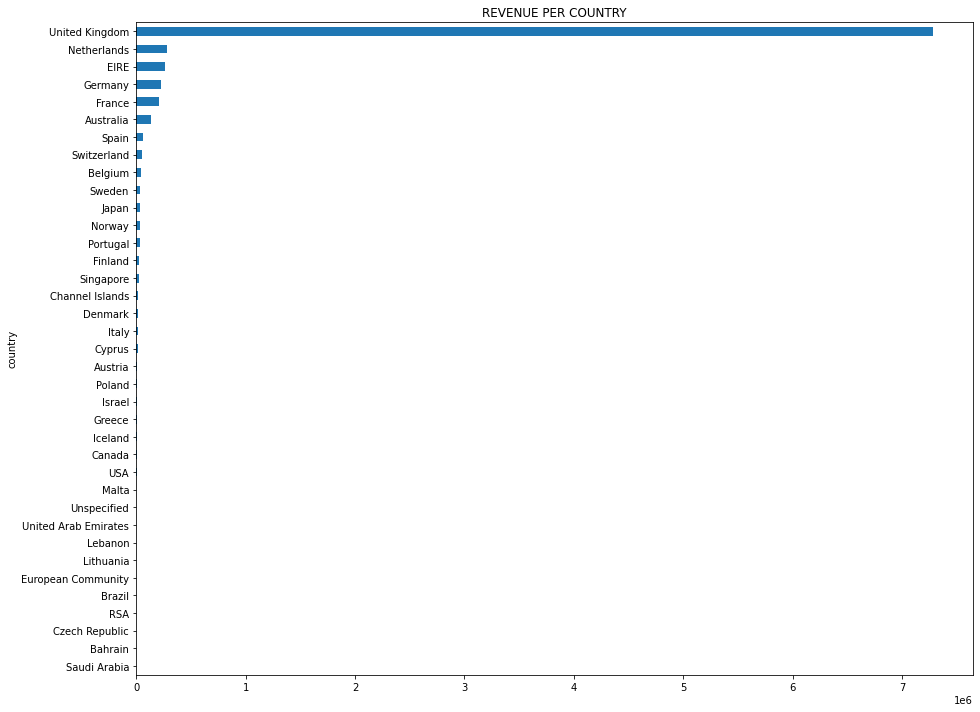

In [42]:
total_revenue = data.groupby(['country'])['total_price'].aggregate('sum').sort_values()
total_revenue.plot(kind = 'barh',figsize=(15,12))
plt.title('REVENUE PER COUNTRY')
plt.show()

In [43]:
data.groupby(['country'])['invoice_no'].aggregate('count').reset_index().sort_values('invoice_no',ascending=False)

,country,invoice_no
35,United Kingdom,349227
14,Germany,9027
13,France,8327
10,EIRE,7228
30,Spain,2480
23,Netherlands,2363
3,Belgium,2031
32,Switzerland,1842
26,Portugal,1453
0,Australia,1184


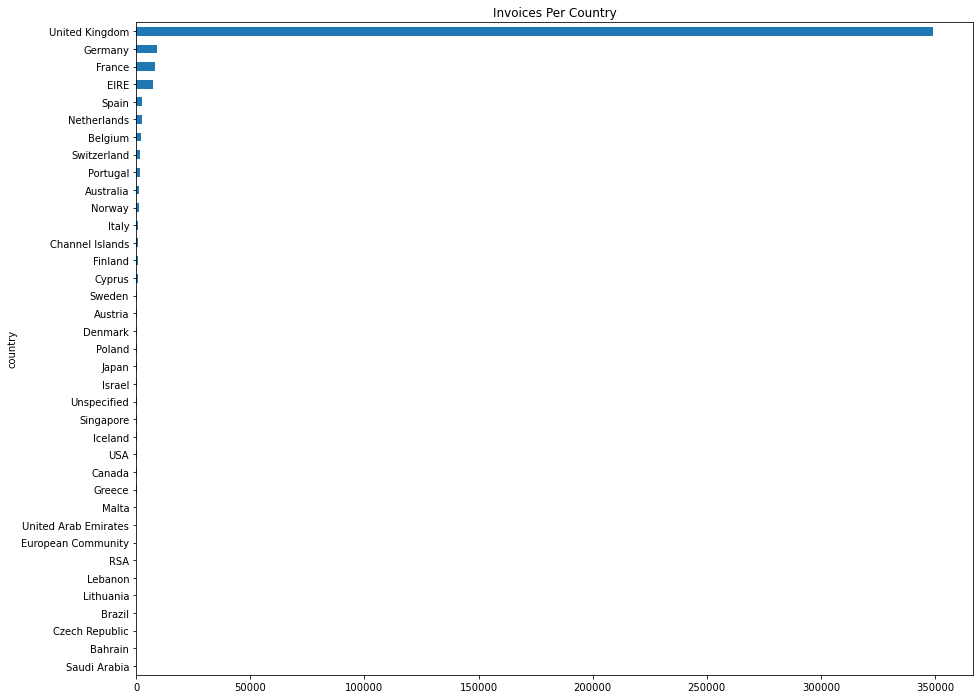

In [44]:
total_invoice = data.groupby(['country'])['invoice_no'].aggregate('count').sort_values()
total_invoice.plot(kind='barh',figsize=(15,12))
plt.title('Invoices Per Country')
plt.show()

In [45]:
sc = data[data['stock_code'].str.contains('^[a-zA-Z]+',regex=True)]['stock_code'].unique()
sc

array(['POST', 'C2', 'M', 'BANK CHARGES', 'PADS', 'DOT'], dtype=object)

In [46]:
#removing unique columns from stock code
data = data[data['stock_code']!='POST']

data = data[data['stock_code']!='C2']

data = data[data['stock_code']!='M']

data = data[data['stock_code']!='BANK CHARGES']

data = data[data['stock_code']!='PADS']

data = data[data['stock_code']!='DOT']

In [47]:
data.shape

(391183, 10)

In [48]:
data['customer_id'] = data['customer_id'].astype('int64')

In [49]:
data.describe()

,quantity,unit_price,customer_id,total_price
count,391183.000000,391183.000000,391183.000000,391183.000000
mean,13.179665,2.874130,15295.083503,22.335397
std,181.907403,4.284639,1710.359579,310.919394
min,1.000000,0.000000,12346.000000,0.000000
25%,2.000000,1.250000,13969.000000,4.950000
50%,6.000000,1.950000,15158.000000,11.900000
75%,12.000000,3.750000,16794.000000,19.800000
max,80995.000000,649.500000,18287.000000,168469.600000


In [50]:
data[data['unit_price']==0]

,invoice_no,stock_code,description,quantity,invoice_date,unit_price,customer_id,country,cancelled_orders,total_price
9302,537197,22841,ROUND CAKE TIN VINTAGE GREEN,1,12/5/2010 14:02,0.0,12647,Germany,Satisfied,0.0
33576,539263,22580,ADVENT CALENDAR GINGHAM SACK,4,12/16/2010 14:36,0.0,16560,United Kingdom,Satisfied,0.0
40089,539722,22423,REGENCY CAKESTAND 3 TIER,10,12/21/2010 13:45,0.0,14911,EIRE,Satisfied,0.0
47068,540372,22090,PAPER BUNTING RETROSPOT,24,1/6/2011 16:41,0.0,13081,United Kingdom,Satisfied,0.0
47070,540372,22553,PLASTERS IN TIN SKULLS,24,1/6/2011 16:41,0.0,13081,United Kingdom,Satisfied,0.0
56674,541109,22168,ORGANISER WOOD ANTIQUE WHITE,1,1/13/2011 15:10,0.0,15107,United Kingdom,Satisfied,0.0
86789,543599,84535B,FAIRY CAKES NOTEBOOK A6 SIZE,16,2/10/2011 13:08,0.0,17560,United Kingdom,Satisfied,0.0
130188,547417,22062,CERAMIC BOWL WITH LOVE HEART DESIGN,36,3/23/2011 10:25,0.0,13239,United Kingdom,Satisfied,0.0
139453,548318,22055,MINI CAKE STAND HANGING STRAWBERY,5,3/30/2011 12:45,0.0,13113,United Kingdom,Satisfied,0.0
145208,548871,22162,HEART GARLAND RUSTIC PADDED,2,4/4/2011 14:42,0.0,14410,United Kingdom,Satisfied,0.0


<AxesSubplot:xlabel='quantity'>

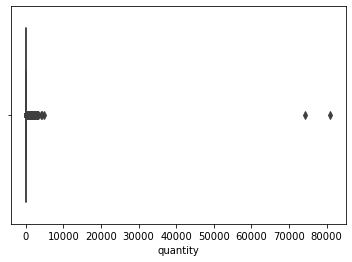

In [203]:
sns.boxplot(data['quantity'])

In [204]:
# Removing Outliers
Q1 = data['quantity'].quantile(0.25)
Q3 = data['quantity'].quantile(0.75)
IQR = Q3 - Q1

data = data[~((data['quantity'] < (Q1 - 1.5 * IQR)) |(data['quantity'] > (Q3 + 1.5 * 
IQR)))]

<AxesSubplot:xlabel='quantity'>

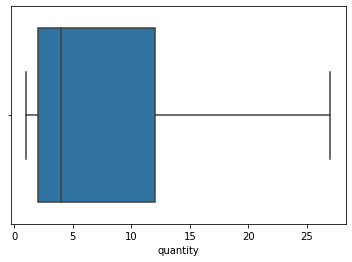

In [205]:
sns.boxplot(data['quantity'])

# Using RFM technique to Segment Customers

What is the RFM?

The Recency, Frequency, & Monetary (RFM) Model is a classic analytics and segmentation tool for identifying your best customers. RFM Model is a powerful way to identify group of customer for special treatment.

## Recency
### How recently a customer has made a purchase.

In [292]:
data['invoice_date'] = pd.to_datetime(data['invoice_date'])

for recency first we have to know the last purchase date

In [293]:
data['ref_date'] = pd.to_datetime(data['invoice_date']).dt.date.max()

In [294]:
data['ref_date'] = pd.to_datetime(data['ref_date'])

In [295]:
data.head(5)

,invoice_no,stock_code,description,quantity,invoice_date,unit_price,customer_id,country,cancelled_orders,total_price,ref_date,last_purchase_date,customer_recency,customer_frequency,customer_monetary
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2010-12-01 08:26:00,2.55,17850,United Kingdom,Satisfied,15.30,2011-12-09,2010-12-02,372,297,5391.21
1,536365,71053,WHITE METAL LANTERN,6,2010-12-01 08:26:00,3.39,17850,United Kingdom,Satisfied,20.34,2011-12-09,2010-12-02,372,297,5391.21
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,2010-12-01 08:26:00,2.75,17850,United Kingdom,Satisfied,22.00,2011-12-09,2010-12-02,372,297,5391.21
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,2010-12-01 08:26:00,3.39,17850,United Kingdom,Satisfied,20.34,2011-12-09,2010-12-02,372,297,5391.21
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,2010-12-01 08:26:00,3.39,17850,United Kingdom,Satisfied,20.34,2011-12-09,2010-12-02,372,297,5391.21


In [296]:
#last purchase date of every customer
data['last_purchase_date'] = data.groupby('customer_id')['invoice_date'].transform(max)
data.head(1)

,invoice_no,stock_code,description,quantity,invoice_date,unit_price,customer_id,country,cancelled_orders,total_price,ref_date,last_purchase_date,customer_recency,customer_frequency,customer_monetary
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2010-12-01 08:26:00,2.55,17850,United Kingdom,Satisfied,15.3,2011-12-09,2010-12-02 15:27:00,372,297,5391.21


In [297]:
data['last_purchase_date'] = pd.to_datetime(data['last_purchase_date']).dt.date
data['last_purchase_date'] = pd.to_datetime(data['last_purchase_date'])

In [298]:
data['customer_recency'] = data['ref_date'] - data['last_purchase_date']
data.head(20)

,invoice_no,stock_code,description,quantity,invoice_date,unit_price,customer_id,country,cancelled_orders,total_price,ref_date,last_purchase_date,customer_recency,customer_frequency,customer_monetary
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2010-12-01 08:26:00,2.55,17850,United Kingdom,Satisfied,15.30,2011-12-09,2010-12-02,372 days,297,5391.21
1,536365,71053,WHITE METAL LANTERN,6,2010-12-01 08:26:00,3.39,17850,United Kingdom,Satisfied,20.34,2011-12-09,2010-12-02,372 days,297,5391.21
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,2010-12-01 08:26:00,2.75,17850,United Kingdom,Satisfied,22.00,2011-12-09,2010-12-02,372 days,297,5391.21
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,2010-12-01 08:26:00,3.39,17850,United Kingdom,Satisfied,20.34,2011-12-09,2010-12-02,372 days,297,5391.21
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,2010-12-01 08:26:00,3.39,17850,United Kingdom,Satisfied,20.34,2011-12-09,2010-12-02,372 days,297,5391.21
5,536365,22752,SET 7 BABUSHKA NESTING BOXES,2,2010-12-01 08:26:00,7.65,17850,United Kingdom,Satisfied,15.30,2011-12-09,2010-12-02,372 days,297,5391.21
6,536365,21730,GLASS STAR FROSTED T-LIGHT HOLDER,6,2010-12-01 08:26:00,4.25,17850,United Kingdom,Satisfied,25.50,2011-12-09,2010-12-02,372 days,297,5391.21
7,536366,22633,HAND WARMER UNION JACK,6,2010-12-01 08:28:00,1.85,17850,United Kingdom,Satisfied,11.10,2011-12-09,2010-12-02,372 days,297,5391.21
8,536366,22632,HAND WARMER RED POLKA DOT,6,2010-12-01 08:28:00,1.85,17850,United Kingdom,Satisfied,11.10,2011-12-09,2010-12-02,372 days,297,5391.21
10,536367,22745,POPPY'S PLAYHOUSE BEDROOM,6,2010-12-01 08:34:00,2.10,13047,United Kingdom,Satisfied,12.60,2011-12-09,2011-10-14,56 days,170,3178.51


In [299]:
#Removing "days" from customer_recency in our dataset
data['customer_recency'] = pd.to_numeric(data['customer_recency'].dt.days.astype('int64'))

In [300]:
#creating a Dataframe for Recency
customer_recency = pd.DataFrame(data.groupby('customer_id')['customer_recency'].min())
customer_recency.rename(columns={'customer_id':'customer_recency'},inplace=True)
customer_recency.reset_index(inplace=True)
customer_recency.head(5)
customer_recency

,customer_id,customer_recency
0,12347,2
1,12348,248
2,12349,18
3,12350,310
4,12352,36
...,...,...
4222,18280,277
4223,18281,180
4224,18282,7
4225,18283,3


In [301]:
fig = px.histogram(data, x = 'customer_recency', title = 'Customer Recency Distribution')
fig.show()

In [302]:
cprint("From the above graph we see that\nHow many customers have how much Recency",'green')

From the above graph we see that
How many customers have how much Recency


## Frequency
### How often a customer makes a purchase.

In [220]:
# For Frequency we have to count the invoices of each customers 
data['customer_frequency'] = data.groupby(['customer_id'])['invoice_no'].transform('count')

In [221]:
#Creating a Dataframe for Frequency
customer_frequency = pd.DataFrame(data.groupby('customer_id')['invoice_no'].count())
customer_frequency.rename(columns={'invoice_no':'customer_frequency'}, inplace=True)
customer_frequency.reset_index(inplace=True)
customer_frequency

,customer_id,customer_frequency
0,12347,173
1,12348,6
2,12349,70
3,12350,16
4,12352,77
...,...,...
4222,18280,10
4223,18281,7
4224,18282,11
4225,18283,719


In [222]:
data['customer_frequency'].min()

1

In [223]:
data[data['customer_frequency']==1]

,invoice_no,stock_code,description,quantity,invoice_date,unit_price,customer_id,country,cancelled_orders,total_price,ref_date,last_purchase_date,customer_recency,customer_frequency,customer_monetary
252,536393,22180,RETROSPOT LAMP,8,2010-12-01 10:37:00,9.95,13747,United Kingdom,Satisfied,79.60,2011-12-09,2010-12-01,373,1,79.60
4988,536834,21111,"SWISS ROLL TOWEL, CHOCOLATE SPOTS",12,2010-12-02 17:51:00,2.95,14576,United Kingdom,Satisfied,35.40,2011-12-09,2010-12-02,372,1,35.40
20402,538048,84534B,FAIRY CAKE NOTEBOOK A5 SIZE,16,2010-12-09 13:14:00,0.85,15945,United Kingdom,Satisfied,13.60,2011-12-09,2010-12-09,365,1,181.00
33701,539288,22492,MINI PAINT SET VINTAGE,10,2010-12-16 16:28:00,0.55,17857,United Kingdom,Satisfied,5.50,2011-12-09,2010-12-16,358,1,25301.54
49210,540507,84029E,RED WOOLLY HOTTIE WHITE HEART.,24,2011-01-09 11:20:00,3.39,12939,United Kingdom,Satisfied,81.36,2011-12-09,2011-01-09,334,1,11581.80
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
476400,577011,22993,SET OF 4 PANTRY JELLY MOULDS,24,2011-11-17 12:19:00,1.25,15657,United Kingdom,Satisfied,30.00,2011-12-09,2011-11-17,22,1,30.00
481038,577334,23133,LARGE IVORY HEART WALL ORGANISER,2,2011-11-18 14:42:00,8.25,15368,United Kingdom,Satisfied,16.50,2011-12-09,2011-11-18,21,1,446.94
512995,579526,85230B,CINNAMON SCENTED VOTIVE CANDLE,24,2011-11-30 08:38:00,0.29,18058,United Kingdom,Satisfied,6.96,2011-12-09,2011-11-30,9,1,170.16
519645,580159,21034,REX CASH+CARRY JUMBO SHOPPER,2,2011-12-02 10:45:00,0.95,17942,United Kingdom,Satisfied,1.90,2011-12-09,2011-12-02,7,1,77.50


In [224]:
data[data['customer_id']==12791]

,invoice_no,stock_code,description,quantity,invoice_date,unit_price,customer_id,country,cancelled_orders,total_price,ref_date,last_purchase_date,customer_recency,customer_frequency,customer_monetary


In [225]:
data['customer_frequency'].max()

7622

In [226]:
fig1 = px.histogram(data,x = 'customer_frequency',title='CUSTOMER FREQUENCY DISTRIBUTION')
fig1.show()

In [227]:
cprint('From the above graph we see that\nHow much customers makes a purchase how many times','green')

From the above graph we see that
How much customers makes a purchase how many times


## Monetary
### How much money a customer spends on purchases.

In [228]:
# for monetary we have to sum the total price of each customer
data['customer_monetary'] = data.groupby(['customer_id'])['total_price'].transform('sum')
data.head(5)

,invoice_no,stock_code,description,quantity,invoice_date,unit_price,customer_id,country,cancelled_orders,total_price,ref_date,last_purchase_date,customer_recency,customer_frequency,customer_monetary
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2010-12-01 08:26:00,2.55,17850,United Kingdom,Satisfied,15.30,2011-12-09,2010-12-02,372,297,5391.21
1,536365,71053,WHITE METAL LANTERN,6,2010-12-01 08:26:00,3.39,17850,United Kingdom,Satisfied,20.34,2011-12-09,2010-12-02,372,297,5391.21
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,2010-12-01 08:26:00,2.75,17850,United Kingdom,Satisfied,22.00,2011-12-09,2010-12-02,372,297,5391.21
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,2010-12-01 08:26:00,3.39,17850,United Kingdom,Satisfied,20.34,2011-12-09,2010-12-02,372,297,5391.21
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,2010-12-01 08:26:00,3.39,17850,United Kingdom,Satisfied,20.34,2011-12-09,2010-12-02,372,297,5391.21


In [229]:
#Creating a Dataframe for Monetary
customer_monetary = pd.DataFrame(data.groupby('customer_id')['total_price'].sum())
customer_monetary.rename(columns={'total_price':'customer_monetary'}, inplace=True)
customer_monetary.reset_index(inplace=True)
customer_monetary.head(5)

,customer_id,customer_monetary
0,12347,3643.58
1,12348,90.20
2,12349,1367.55
3,12350,294.40
4,12352,1385.74


In [230]:
fig2 = px.histogram(data,x='customer_monetary',title='CUSTOMER MONETARY DISTRIBUTION')
fig2.show()

In [231]:
cprint('Above graph we can say that hou much customers\nspent how much','green')

Above graph we can say that hou much customers
spent how much


In [232]:
customer_rfm = pd.merge(pd.merge(customer_recency,customer_frequency,on='customer_id'),customer_monetary,on='customer_id')
customer_rfm

,customer_id,customer_recency,customer_frequency,customer_monetary
0,12347,2,173,3643.58
1,12348,248,6,90.20
2,12349,18,70,1367.55
3,12350,310,16,294.40
4,12352,36,77,1385.74
...,...,...,...,...
4222,18280,277,10,180.60
4223,18281,180,7,80.82
4224,18282,7,11,164.13
4225,18283,3,719,2039.58


In [233]:
customer_rfm.head()

,customer_id,customer_recency,customer_frequency,customer_monetary
0,12347,2,173,3643.58
1,12348,248,6,90.20
2,12349,18,70,1367.55
3,12350,310,16,294.40
4,12352,36,77,1385.74


In [234]:
customer_rfm.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4227 entries, 0 to 4226
Data columns (total 4 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   customer_id         4227 non-null   int64  
 1   customer_recency    4227 non-null   int64  
 2   customer_frequency  4227 non-null   int64  
 3   customer_monetary   4227 non-null   float64
dtypes: float64(1), int64(3)
memory usage: 165.1 KB


In [235]:
customer_rfm.shape

(4227, 4)

In [236]:
customer_rfm.isnull().sum()

customer_id           0
customer_recency      0
customer_frequency    0
customer_monetary     0
dtype: int64

## Segmenting Customers

Benefites of customer segmentation

1) Identify least and most profitable customers, thus helping the business to concentrate marketing activities.

2) Build loyal relationships with customers by developing and offering them the products and service they want.

3) Improve customer service

4) Maximize the use of your services

5) Improve products to meet customer requirements.

In [237]:
customer_rfm.head(2)

,customer_id,customer_recency,customer_frequency,customer_monetary
0,12347,2,173,3643.58
1,12348,248,6,90.20


In [238]:
# WE have to Seperate RFM in quantiles

In [239]:
customer_rfm['customer_recency'].quantile(q=[0.25,0.50,0.75])

0.25     17.0
0.50     50.0
0.75    144.0
Name: customer_recency, dtype: float64

In [240]:
cprint('Recency','blue')
def rec_score(x):
    if x < 17.000:
        return 4
    elif 17.000 <= x < 50.000:
        return 3
    elif 50.000 <= x < 142.0: 
        return 2
    else:
        return 1

Recency


In [241]:
customer_rfm['customer_frequency'].quantile(q=[0.25,0.50,0.75])

0.25    16.0
0.50    39.0
0.75    95.0
Name: customer_frequency, dtype: float64

In [242]:
cprint('Frequency','yellow')
def freq_score(x):
    if x > 98.0:
        return 4
    elif 98.0 >= x > 41.0:
        return 3
    elif 41.0 >= x > 17.0: 
        return 2
    else:
        return 1

Frequency


In [243]:
customer_rfm['customer_monetary'].quantile(q=[0.25,0.50,0.75])

0.25     250.095
0.50     568.600
0.75    1331.640
Name: customer_monetary, dtype: float64

In [244]:
cprint('Monetary','red')
def mon_score(x):
    if x > 1631.6225:
        return 4
    elif 1631.6225 >= x > 662.5650:
        return 3
    elif 662.5650 >= x > 304.2400: 
        return 2
    else:
        return 1

Monetary


In [245]:
customer_rfm['recency_score'] = customer_rfm['customer_recency'].apply(rec_score)
customer_rfm['frequency_score'] = customer_rfm['customer_frequency'].apply(freq_score)
customer_rfm['monetary_score'] = customer_rfm['customer_monetary'].apply(mon_score)
customer_rfm.head(5)

,customer_id,customer_recency,customer_frequency,customer_monetary,recency_score,frequency_score,monetary_score
0,12347,2,173,3643.58,4,4,4
1,12348,248,6,90.20,1,1,1
2,12349,18,70,1367.55,3,3,3
3,12350,310,16,294.40,1,1,1
4,12352,36,77,1385.74,3,3,3


In [246]:
customer_rfm.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4227 entries, 0 to 4226
Data columns (total 7 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   customer_id         4227 non-null   int64  
 1   customer_recency    4227 non-null   int64  
 2   customer_frequency  4227 non-null   int64  
 3   customer_monetary   4227 non-null   float64
 4   recency_score       4227 non-null   int64  
 5   frequency_score     4227 non-null   int64  
 6   monetary_score      4227 non-null   int64  
dtypes: float64(1), int64(6)
memory usage: 264.2 KB


In [247]:
print('-'*50)
cprint('Now We add our RFM score','blue')
print('-'*50)

--------------------------------------------------
Now We add our RFM score
--------------------------------------------------


In [248]:
customer_rfm['RFM_score'] = (customer_rfm['recency_score'] + customer_rfm['frequency_score'] + 
                            customer_rfm['monetary_score'])
customer_rfm.head(10)

,customer_id,customer_recency,customer_frequency,customer_monetary,recency_score,frequency_score,monetary_score,RFM_score
0,12347,2,173,3643.58,4,4,4,12
1,12348,248,6,90.20,1,1,1,3
2,12349,18,70,1367.55,3,3,3,9
3,12350,310,16,294.40,1,1,1,3
4,12352,36,77,1385.74,3,3,3,9
5,12353,204,4,89.00,1,1,1,3
6,12354,232,54,916.84,1,3,3,7
7,12355,214,11,264.40,1,1,1,3
8,12356,22,41,1662.59,3,2,4,9
9,12357,33,111,4327.21,3,4,4,11


In [249]:
customer_rfm['RFM_score'].value_counts()

5     529
8     444
4     439
7     438
6     436
3     433
9     394
10    380
12    379
11    355
Name: RFM_score, dtype: int64

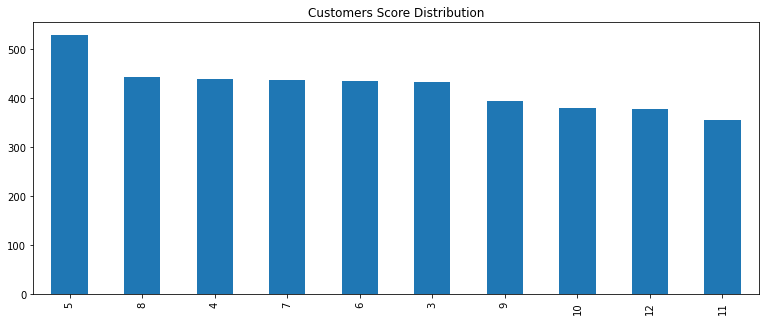

In [250]:
customer_rfm['RFM_score'].value_counts().plot(kind='bar',figsize=(13,5))
plt.title('Customers Score Distribution')
plt.show()

In [251]:
customer_rfm['RFM_score'].quantile(q=[0.25,0.50,0.75])

0.25     5.0
0.50     7.0
0.75    10.0
Name: RFM_score, dtype: float64

In [252]:
customer_rfm["customer_category"] = np.where(customer_rfm['RFM_score'] > 10,"High value Customer",(np.where(customer_rfm['RFM_score'] > 7,"Medium Value Customer",np.where(customer_rfm['RFM_score'] > 5,'Low Value Customers', 'Lost Customers'))))
customer_rfm[['customer_id','RFM_score', 'customer_category']].head(20)

,customer_id,RFM_score,customer_category
0,12347,12,High value Customer
1,12348,3,Lost Customers
2,12349,9,Medium Value Customer
3,12350,3,Lost Customers
4,12352,9,Medium Value Customer
5,12353,3,Lost Customers
6,12354,7,Low Value Customers
7,12355,3,Lost Customers
8,12356,9,Medium Value Customer
9,12357,11,High value Customer


In [253]:
customer_rfm['customer_category'].value_counts()

Lost Customers           1401
Medium Value Customer    1218
Low Value Customers       874
High value Customer       734
Name: customer_category, dtype: int64

In [254]:
fig = px.histogram(customer_rfm, x = customer_rfm['customer_category'].value_counts().index, 
                   y = customer_rfm['customer_category'].value_counts().values, 
                   title = 'Customer_Segment Distribution',
                   labels = dict(x = "customer_category", y ="counts"))
fig.show()

In [255]:
segmentation = pd.DataFrame(customer_rfm.customer_category.value_counts(dropna=False).sort_values(ascending=False))
segmentation.reset_index(inplace=True)
segmentation.rename(columns={'index':'Customer Category', 'Customer_Category':'The Number Of Customer'}, inplace=True)
segmentation

,Customer Category,customer_category
0,Lost Customers,1401
1,Medium Value Customer,1218
2,Low Value Customers,874
3,High value Customer,734


In [256]:
customer_rfm.head(3)

,customer_id,customer_recency,customer_frequency,customer_monetary,recency_score,frequency_score,monetary_score,RFM_score,customer_category
0,12347,2,173,3643.58,4,4,4,12,High value Customer
1,12348,248,6,90.20,1,1,1,3,Lost Customers
2,12349,18,70,1367.55,3,3,3,9,Medium Value Customer


# K Means Clustering

In [257]:
rfm_scaled = customer_rfm[['customer_recency','customer_frequency','customer_monetary']]

In [258]:
from sklearn.preprocessing import StandardScaler

In [259]:
scaler = StandardScaler()

In [260]:
#first we have to scaled the columns 
rfm_scaled = scaler.fit_transform(rfm_scaled)
rfm_scaled.shape

(4227, 3)

In [261]:
#converting hem array to dataframe
rfm_scaled = pd.DataFrame(rfm_scaled)
rfm_scaled.columns = ['Recency','Frequency','Monetary']
rfm_scaled.head()

,Recency,Frequency,Monetary
0,-0.902227,0.398946,0.887284
1,1.554940,-0.371106,-0.416507
2,-0.742411,-0.075996,0.052173
3,2.174225,-0.324995,-0.341583
4,-0.562618,-0.043719,0.058847


In [262]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples,silhouette_score

[8586.271461212997, 5022.800666750405, 3356.8002169992374, 2729.924502703745, 2264.9723680566226, 1829.365616088003, 1494.7952364884213, 1347.6821179010103, 1203.7210544090822, 1076.6088710777365, 953.1334836867093, 863.9886370218026, 790.1145619392211]


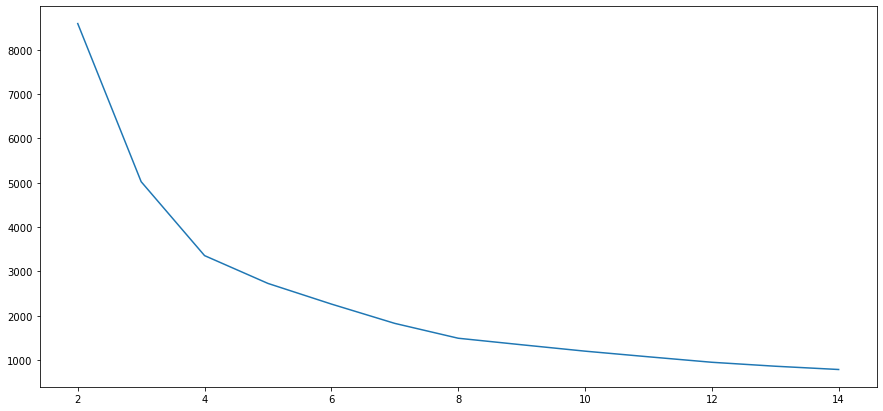

In [263]:
from sklearn.cluster import KMeans
wss = []
k = range(2,15)
for k in k:
    kmeans = KMeans(n_clusters=k,random_state=1000).fit(rfm_scaled)
    wss.append(kmeans.inertia_)

    
print(wss)
plt.figure(figsize=(15,7))
sns.lineplot(x=range(2,15),y=wss)
plt.show()

In [265]:
#Checking scores on clusters 

n_clusters = (3,4,5,6,7,8)
for num_clusters in n_clusters:
    kmeans=KMeans(n_clusters=num_clusters,max_iter=50)
    kmeans.fit_predict(rfm_scaled)
    cluster_labels = kmeans.labels_
    
    silhouette = silhouette_score(rfm_scaled,cluster_labels)
    print("For n_clusters={0},the silhouette score is{1}".format(num_clusters,silhouette))
    

For n_clusters=3,the silhouette score is0.5565463711517027
For n_clusters=4,the silhouette score is0.5923459729045444
For n_clusters=5,the silhouette score is0.5811495117602196
For n_clusters=6,the silhouette score is0.5803632004307495
For n_clusters=7,the silhouette score is0.49383144348175145
For n_clusters=8,the silhouette score is0.47474230073849966


In [266]:
#lets choose cluster 4 
kmeans = KMeans(n_clusters=4, max_iter=50)
kmeans.fit(rfm_scaled)

KMeans(max_iter=50, n_clusters=4)

In [267]:
silhouette_score(rfm_scaled,kmeans.labels_)

0.5923459729045444

In [303]:
#assigning clusters to customers
cprint('ASSIGNING CLUSTERS','green')

customer_rfm['cluster'] = customer_rfm['customer_category'].map({'Lost Customers':0,'Low Value Customers':1,
                                                                 'Medium Value Customer':2,
                                                                'High value Customer':3})

ASSIGNING CLUSTERS


In [304]:
customer_rfm['cluster'].value_counts()

0    1401
2    1218
1     874
3     734
Name: cluster, dtype: int64

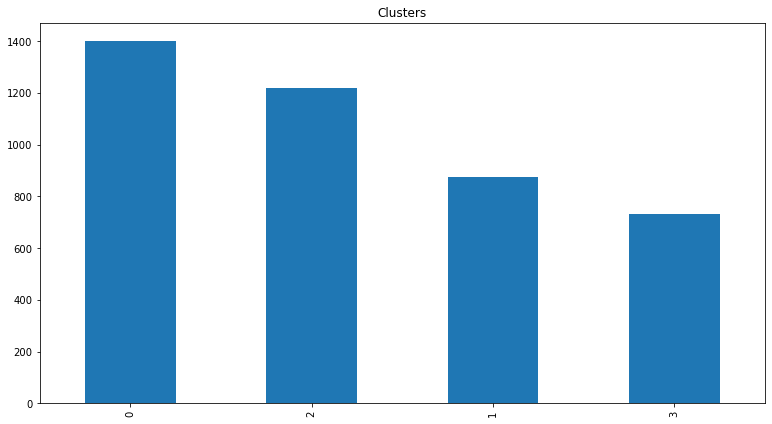

In [305]:
customer_rfm['cluster'].value_counts().plot(kind='bar',figsize=(13,7))
plt.title('Clusters')
plt.show()

In [306]:
fig = px.pie(customer_rfm,values=customer_rfm['cluster'].value_counts(),
             names= (customer_rfm['cluster'].value_counts()).index)
fig

## Cluster 0 -----------> LOST CUSTOMERS
## Cluster 1 -----------> LOW VALUE CUSTOMERS
## Cluster 2 -----------> MEDIUM VALUE CUSTOMERS
## Cluster 3 -----------> HIGH VALUE CUSTOMERS

In [307]:
# customer_rfm.to_csv()

,customer_id,customer_recency,customer_frequency,customer_monetary,recency_score,frequency_score,monetary_score,RFM_score,customer_category,cluster
0,12347,2,173,3643.58,4,4,4,12,High value Customer,3
1,12348,248,6,90.20,1,1,1,3,Lost Customers,0
2,12349,18,70,1367.55,3,3,3,9,Medium Value Customer,2
3,12350,310,16,294.40,1,1,1,3,Lost Customers,0
4,12352,36,77,1385.74,3,3,3,9,Medium Value Customer,2
